In [1]:
import pandas as pd
import numpy as np
import os.path
import json

In [2]:
# Read from data from csv files
df_meta=pd.read_csv('df_meta.csv')
df_features=pd.read_csv('df_features.csv')

In [3]:
# Plot by station
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from sklearn.decomposition import PCA as sklearnPCA
from sklearn.preprocessing import StandardScaler
import plotly.offline as offline
from plotly.graph_objs import *
import plotly.tools as tls
offline.init_notebook_mode()

# df_features = df_features.drop_duplicates()
u = np.unique(df_meta['Name'])
print(u)

# Normalise data
X_std = StandardScaler().fit_transform(df_features)
y = df_meta['Name']

# Apply PCA 
sklearn_pca = sklearnPCA(n_components=3)
Y_sklearn = sklearn_pca.fit_transform(X_std)

traces = []

for name in u:
#     print(name)
    trace = Scatter3d(
        x=Y_sklearn[y==name,0],
        y=Y_sklearn[y==name,1],
        z=Y_sklearn[y==name,2],
        mode='markers',
        name=name,
        marker=Marker(
            size=12,
            line=Line(
                color='rgba(217, 217, 217, 0.14)',
                width=0.5),
            opacity=1))
    traces.append(trace)


data = Data(traces)
layout = Layout(xaxis=XAxis(title='PC1', showline=False),
                yaxis=YAxis(title='PC2', showline=False))
fig = Figure(data=data, layout=layout)
offline.iplot(fig)

['bbc_1xtra' 'bbc_6music' 'bbc_asian_network' 'bbc_music_jazz'
 'bbc_radio_manchester' 'bbc_radio_nan_gaidheal' 'bbc_radio_one'
 'bbc_radio_scotland_fm' 'bbc_radio_scotland_music_extra'
 'bbc_radio_three' 'bbc_radio_two' 'bbc_radio_two_country']


In [483]:
# Split timestamp into time and date
time=pd.to_datetime(df_meta['Date'])
df_meta['new_date'] = [d.date() for d in time]
df_meta['new_time'] = [d.time() for d in time]

In [10]:
# Filter by the radio station
filtered_names = df_meta.loc[df_meta['Name'].isin(['bbc_6music'])]
filtered_names.index

Int64Index([ 9237,  9238,  9239,  9240,  9241,  9242,  9243,  9244,  9245,
             9246,
            ...
            14973, 14974, 14975, 14976, 14977, 14978, 14979, 14980, 14981,
            14982],
           dtype='int64', length=5746)

In [9]:
import matplotlib.pyplot as plt
%matplotlib inline

In [10]:
df_meta.groupby('Name').count().sort_values("Artist", ascending=False)

,Unnamed: 0,Artist,Date,ID,Number,Show,Song,Station,Track_ID,new_date,new_time
Name,,,,,,,,,,,
bbc_radio_one,11926,11926,11926,11926,11926,11926,11926,11926,11926,11926,11926
bbc_1xtra,9237,9237,9237,9237,9237,9237,9237,9237,9237,9237,9237
bbc_asian_network,7176,7176,7176,7168,7176,7168,7176,7176,7176,7176,7176
bbc_6music,5746,5746,5746,5705,5746,5705,5746,5746,5746,5746,5746
bbc_radio_manchester,5258,5258,5258,5258,5258,5258,5258,5258,5258,5258,5258
bbc_radio_two,3506,3506,3506,3486,3506,3486,3506,3506,3506,3506,3506
bbc_radio_three,3225,3225,3225,3191,3225,3191,3225,3225,3225,3225,3225
bbc_radio_scotland_fm,1701,1701,1701,1687,1701,1687,1701,1701,1701,1701,1701
bbc_radio_nan_gaidheal,219,219,219,219,219,219,219,219,219,219,219


Text(0,0.5,'Number of radio stations')

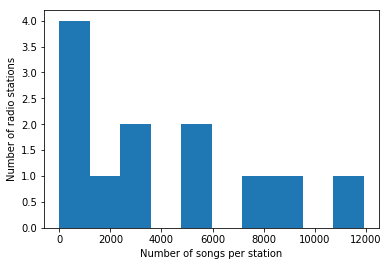

In [13]:
# Plot song distribution across stations
plt.hist(df_meta.groupby('Name').count().sort_values("Song", ascending=False)['Song'])
plt.xlabel('Number of songs per station')
plt.ylabel('Number of radio stations')

Text(0,0.5,'Number of shows')

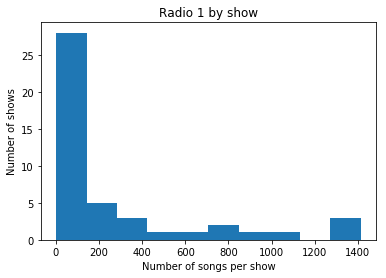

In [7]:
# Song distribution across shows for R1
filtered_names_R1 = df_meta.loc[df_meta['Name'].isin(['bbc_radio_one'])]
plt.hist(filtered_names_R1.groupby('Show').count().sort_values("Artist", ascending=False)['Artist'])
plt.title("Radio 1 by show")
plt.xlabel('Number of songs per show')
plt.ylabel('Number of shows')

Text(0,0.5,'Number of shows')

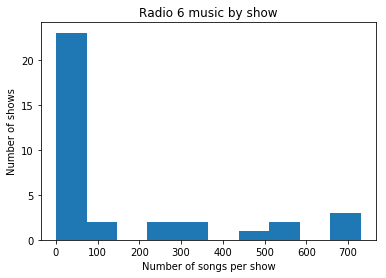

In [15]:
# Song distribution across shows for R6
filtered_names_R6 = df_meta.loc[df_meta['Name'].isin(['bbc_6music'])]
plt.hist(filtered_names_R6.groupby('Show').count().sort_values("Artist", ascending=False)['Artist'])
plt.title("Radio 6 music by show")
plt.xlabel('Number of songs per show')
plt.ylabel('Number of shows')

Text(0,0.5,'Number of shows')

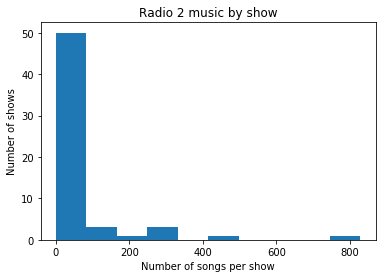

In [16]:
# Song distribution across shows for R2
filtered_names_R2 = df_meta.loc[df_meta['Name'].isin(['bbc_radio_two'])]
plt.hist(filtered_names_R2.groupby('Show').count().sort_values("Artist", ascending=False)['Artist'])
plt.title("Radio 2 music by show")
plt.xlabel('Number of songs per show')
plt.ylabel('Number of shows')

Text(0,0.5,'Number of shows')

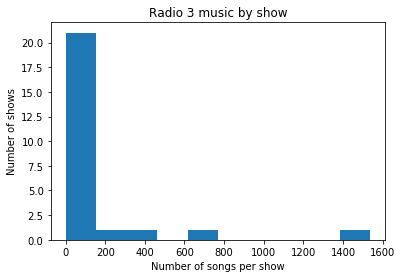

In [17]:
# Song distribution across shows for R3
filtered_names_R3 = df_meta.loc[df_meta['Name'].isin(['bbc_radio_three'])]
plt.hist(filtered_names_R3.groupby('Show').count().sort_values("Artist", ascending=False)['Artist'])
plt.title("Radio 3 music by show")
plt.xlabel('Number of songs per show')
plt.ylabel('Number of shows')

In [43]:
filtered_names_R3.groupby('Show').count().sort_values("Artist", ascending=False)

,Unnamed: 0,Artist,Date,ID,Name,Number,Song,Station,Track_ID,new_date,new_time
Show,,,,,,,,,,,
Through the Night,1537,1537,1537,1537,1537,1537,1537,1537,1537,1537,1537
Breakfast,714,714,714,714,714,714,714,714,714,714,714
Essential Classics,318,318,318,318,318,318,318,318,318,318,318
In Tune,289,289,289,289,289,289,289,289,289,289,289
Late Junction,135,135,135,135,135,135,135,135,135,135,135
Record Review,36,36,36,36,36,36,36,36,36,36,36
Afternoon on 3,33,33,33,33,33,33,33,33,33,33,33
Radio 3 in Concert,33,33,33,33,33,33,33,33,33,33,33
World on 3,21,21,21,21,21,21,21,21,21,21,21


In [29]:
filtered_names_R6.groupby('Show').count().sort_values("Artist", ascending=False)

,Unnamed: 0,Artist,Date,ID,Name,Number,Song,Station,Track_ID,new_date,new_time
Show,,,,,,,,,,,
Chris Hawkins,730,730,730,730,730,730,730,730,730,730,730
Radcliffe and Maconie,708,708,708,708,708,708,708,708,708,708,708
Lauren Laverne,694,694,694,694,694,694,694,694,694,694,694
Steve Lamacq,576,576,576,576,576,576,576,576,576,576,576
Marc Riley,549,549,549,549,549,549,549,549,549,549,549
Shaun Keaveny,486,486,486,486,486,486,486,486,486,486,486
Mary Anne Hobbs,358,358,358,358,358,358,358,358,358,358,358
6 Music's Jukebox,345,345,345,345,345,345,345,345,345,345,345
Gideon Coe,276,276,276,276,276,276,276,276,276,276,276


In [23]:
filtered_names_R1.groupby('Show').count().sort_values("Artist", ascending=False)

,Unnamed: 0,Artist,Date,ID,Name,Number,Song,Station,Track_ID,new_date,new_time
Show,,,,,,,,,,,
Adele Roberts,1413,1413,1413,1413,1413,1413,1413,1413,1413,1413,1413
Scott Mills,1299,1299,1299,1299,1299,1299,1299,1299,1299,1299,1299
Clara Amfo,1292,1292,1292,1292,1292,1292,1292,1292,1292,1292,1292
The Radio 1 Breakfast Show with Nick Grimshaw,1060,1060,1060,1060,1060,1060,1060,1060,1060,1060,1060
Dev,955,955,955,955,955,955,955,955,955,955,955
The Matt Edmondson Show,793,793,793,793,793,793,793,793,793,793,793
Greg James,771,771,771,771,771,771,771,771,771,771,771
Alice Levine,667,667,667,667,667,667,667,667,667,667,667
Huw Stephens,437,437,437,437,437,437,437,437,437,437,437


In [21]:
# Plot of Radio 6 music data by show
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from sklearn.decomposition import PCA as sklearnPCA
from sklearn.preprocessing import StandardScaler
import plotly.offline as offline
from plotly.graph_objs import *
import plotly.tools as tls
offline.init_notebook_mode()

# df_features = df_features.drop_duplicates()
u = np.unique(filtered_names_R6['Show'])
print(u)
X_std = StandardScaler().fit_transform(df_features.iloc[filtered_names_R6.index])
y = filtered_names_R6['Show']

sklearn_pca = sklearnPCA(n_components=3)
Y_sklearn = sklearn_pca.fit_transform(X_std)

traces = []

for name in u:
#     print(name)
    trace = Scatter3d(
        x=Y_sklearn[y==name,0],
        y=Y_sklearn[y==name,1],
        z=Y_sklearn[y==name,2],
        mode='markers',
        name=name,
        marker=Marker(
            size=12,
            line=Line(
                color='rgba(217, 217, 217, 0.14)',
                width=0.5),
            opacity=1))
    traces.append(trace)


data = Data(traces)
layout = Layout(xaxis=XAxis(title='PC1', showline=False),
                yaxis=YAxis(title='PC2', showline=False))
fig = Figure(data=data, layout=layout)
offline.iplot(fig)

[nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan nan
 nan nan nan nan nan '6 Music Classic Concert' '6 Music Live Hour'
 '6 Music Playlist' '6 Music Recommends' '6 Music Recommends Day'
 "6 Music's Jukebox" 'Cerys on 6' 'Chris Hawkins' 'Don Letts' 'Gideon Coe'
 'Gilles Peterson' 'Glastonbury' "Guy Garvey's Finest Hour" 'Iggy Pop'
 "Jarvis Cocker's Sunday Service" 'Kate Tempest' 'Lauren Laverne'
 'Liz Kershaw' 'Marc Riley' 'Mary Anne Hobbs' "Nemone's Electric Ladyland"
 'Now Playing @6Music' 'Paperback Writers' 'Radcliffe and Maconie'
 'Shaun Keaveny' 'Steve Lamacq' "Steve Lamacq's Roundtable"
 'The 6 Music Festival' 'The BBC Introducing Mixtape'
 'The Craig Charles Funk and Soul Show' 'The First Time With...'
 'The Huey Show' 'The Joy of 6' 'The Tom Robinson Show' 'Tom Ravenscroft']


In [9]:
# Plot of Radio 1 music data by show
import numpy as np
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from sklearn.decomposition import PCA as sklearnPCA
from sklearn.preprocessing import StandardScaler
import plotly.offline as offline
from plotly.graph_objs import *
import plotly.tools as tls
offline.init_notebook_mode()

# df_features = df_features.drop_duplicates()
u = np.unique(filtered_names_R1['Show'])
print(u)
X_std = StandardScaler().fit_transform(df_features.iloc[filtered_names_R1.index])
y = filtered_names_R1['Show']

sklearn_pca = sklearnPCA(n_components=3)
Y_sklearn = sklearn_pca.fit_transform(X_std)

traces = []

for name in u:
#     print(name)
    trace = Scatter3d(
        x=Y_sklearn[y==name,0],
        y=Y_sklearn[y==name,1],
        z=Y_sklearn[y==name,2],
        mode='markers',
        name=name,
        marker=Marker(
            size=12,
            line=Line(
                color='rgba(217, 217, 217, 0.14)',
                width=0.5),
            opacity=1))
    traces.append(trace)


data = Data(traces)
layout = Layout(xaxis=XAxis(title='PC1', showline=False),
                yaxis=YAxis(title='PC2', showline=False))
fig = Figure(data=data, layout=layout)
offline.iplot(fig)

/Users/kristing/miniconda2/envs/tutorial/lib/python2.7/site-packages/plotly/graph_objs/_deprecations.py:372: DeprecationWarning:

plotly.graph_objs.Line is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Line
  - plotly.graph_objs.layout.shape.Line
  - etc.


/Users/kristing/miniconda2/envs/tutorial/lib/python2.7/site-packages/plotly/graph_objs/_deprecations.py:426: DeprecationWarning:

plotly.graph_objs.Marker is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.scatter.Marker
  - plotly.graph_objs.histogram.selected.Marker
  - etc.


/Users/kristing/miniconda2/envs/tutorial/lib/python2.7/site-packages/plotly/graph_objs/_deprecations.py:39: DeprecationWarning:

plotly.graph_objs.Data is deprecated.
Please replace it with a list or tuple of instances of the following types
  - plotly.graph_objs.Scatter
  - plotly.graph_objs.Bar
  - plotly.graph_objs.Area
  - plotly.graph_objs.Histo

['Adele Roberts' 'Alice Levine' 'Annie Mac' "Annie Mac's Friday Night"
 'Annie Nightingale' 'B.Traits' "BBC Radio 1 and 1Xtra's Stories"
 "BBC Radio 1's Big Weekend" "BBC Radio 1's Dance Anthems"
 "BBC Radio 1's Essential Mix" "BBC Radio 1's Residency"
 "BBC Radio 1's Teen Awards" 'BBC Radio 1Xtra Live' 'Benji B'
 'Cel Spellman' 'Christmas and New Year on Radio 1' 'Clara Amfo'
 'DJ Target' 'Danny Howard' 'Dev' 'Diplo and Friends' 'Friction'
 'Glastonbury' 'Greg James' 'Huw Stephens' 'Jordan North' 'MistaJam'
 'Monki' 'Newsbeat' 'Pete Tong' 'Phil Taggart' "Radio 1's Best New Pop"
 "Radio 1's Playlists..." "Radio 1's Specialist Chart"
 'Rock Show with Daniel P Carter' 'Scott Mills' 'Seani B'
 'The Matt Edmondson Show' 'The Number One Show'
 'The Official Chart with Greg James'
 'The Radio 1 Breakfast Show with Nick Grimshaw'
 'The Rap Show with Charlie Sloth' 'The Surgery with Gemma and Dr Radha'
 'Toddla T' 'Yasser']


/Users/kristing/miniconda2/envs/tutorial/lib/python2.7/site-packages/plotly/graph_objs/_deprecations.py:531: DeprecationWarning:

plotly.graph_objs.XAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.XAxis
  - plotly.graph_objs.layout.scene.XAxis


/Users/kristing/miniconda2/envs/tutorial/lib/python2.7/site-packages/plotly/graph_objs/_deprecations.py:558: DeprecationWarning:

plotly.graph_objs.YAxis is deprecated.
Please replace it with one of the following more specific types
  - plotly.graph_objs.layout.YAxis
  - plotly.graph_objs.layout.scene.YAxis


